# Introducción

In [1]:
import os
import pandas as pd
import numpy as np
from IPython.display import display
import pickle
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go
import seaborn as sns
from scipy.stats import chi2
from sklearn.decomposition import PCA
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import scale, MinMaxScaler
from sklearn.metrics import recall_score, precision_score
from sklearn.metrics import matthews_corrcoef, roc_auc_score
from sklearn.metrics import average_precision_score, auc
from sklearn.metrics import make_scorer, confusion_matrix
from sklearn.model_selection import StratifiedKFold
from sklearn.model_selection import cross_validate
from sklearn.model_selection import train_test_split
from sklearn.calibration import CalibratedClassifierCV
from sklearn.calibration import calibration_curve
from skopt import BayesSearchCV
from skopt.space import Real, Categorical, Integer
from feature_engine.encoding import CountFrequencyEncoder
from feature_engine.imputation import MeanMedianImputer
from feature_engine.transformation import YeoJohnsonTransformer
from xgboost import XGBClassifier
from EDA_functions import * 
import shap
shap.initjs()

In [2]:
data_path = 'final_data_test.sav'
data_test = pickle.load(open(data_path, 'rb'))

In [3]:
data_path = 'final_data_train.sav'
data_train = pickle.load(open(data_path, 'rb'))

In [4]:
movie_with_cluster = pickle.load(open('movie_with_cluster.sav',
                                      'rb'))

In [5]:
y_train = data_train['high_rating']
y_test = data_test['high_rating']

In [6]:
print('Distribución del variable objetivo en TRAIN.')
display(y_train.value_counts(normalize=True))
print('Distribución del variable objetivo en TEST.')
display(y_test.value_counts(normalize=True))

Distribución del variable objetivo en TRAIN.


1    0.518518
0    0.481482
Name: high_rating, dtype: float64

Distribución del variable objetivo en TEST.


0    0.641041
1    0.358959
Name: high_rating, dtype: float64

In [7]:
data_test = pd.merge(data_test,
                     movie_with_cluster,
                     how="left",
                     on=["movieId"])

In [8]:
features_names = ['frecc_movies_per_day',
                  'frecc_genre_crime_per_day',
                  'frecc_genre_no genres listed_per_day',
                  'frecc_genre_adventure_per_day',
                  'frecc_genre_romance_per_day', 
                  'frecc_genre_horror_per_day',
                  'frecc_genre_drama_per_day',
                  'frecc_genre_thriller_per_day',
                  'frecc_genre_comedy_per_day',
                  'frecc_genre_imax_per_day',
                  'frecc_genre_documentary_per_day', 
                  'frecc_genre_action_per_day',
                  'frecc_genre_musical_per_day',
                  'frecc_genre_sci-fi_per_day',
                  'frecc_genre_animation_per_day',
                  'frecc_genre_fantasy_per_day',
                  'frecc_genre_children_per_day',
                  'frecc_genre_western_per_day',
                  'frecc_genre_war_per_day',
                  'frecc_genre_mystery_per_day',
                  'frecc_genre_film-noir_per_day',
                  'percencumulativefrecc_genre_crime_per_day',
                  'percencumulativefrecc_genre_no genres listed_per_day',
                  'percencumulativefrecc_genre_adventure_per_day',
                  'percencumulativefrecc_genre_romance_per_day',
                  'percencumulativefrecc_genre_horror_per_day',
                  'percencumulativefrecc_genre_drama_per_day',
                  'percencumulativefrecc_genre_thriller_per_day',
                  'percencumulativefrecc_genre_comedy_per_day',
                  'percencumulativefrecc_genre_imax_per_day',
                  'percencumulativefrecc_genre_documentary_per_day',
                  'percencumulativefrecc_genre_action_per_day',
                  'percencumulativefrecc_genre_musical_per_day',
                  'percencumulativefrecc_genre_sci-fi_per_day',
                  'percencumulativefrecc_genre_animation_per_day',
                  'percencumulativefrecc_genre_fantasy_per_day',
                  'percencumulativefrecc_genre_children_per_day',
                  'percencumulativefrecc_genre_western_per_day',
                  'percencumulativefrecc_genre_war_per_day',
                  'percencumulativefrecc_genre_mystery_per_day',
                  'percencumulativefrecc_genre_film-noir_per_day',
                  'genre_crime',
                  'genre_no genres listed',
                  'genre_adventure',
                  'genre_romance',
                  'genre_horror',
                  'genre_drama',
                  'genre_thriller',
                  'genre_comedy',
                  'genre_imax',
                  'genre_documentary',
                  'genre_action',
                  'genre_musical',
                  'genre_sci-fi',
                  'genre_animation',
                  'genre_fantasy',
                  'genre_children',
                  'genre_western',
                  'genre_war',
                  'genre_mystery',
                  'genre_film-noir',
                  'cluster']

In [9]:
X_test = data_test[features_names]

In [10]:
X_train = data_train[features_names]

# Análisis de la Correlación

In [ ]:
# corrheatmep(data=X_train.drop(['cluster'], axis=1))

# Separación en data de Entrenamiento y Testeo.

In [12]:
seed = 50000

# Curvas de aprendizaje para delimitar el espacio hiperparametral

In [13]:
preprocessing_Pipeline = Pipeline([# Codificar variables categóricas
                                  ('categorical_mean_encoder', CountFrequencyEncoder(variables=['cluster'])),

                                  # Reescalar todas las variables.
                                  ('minmax_scaler', MinMaxScaler())])

In [14]:
X_train['cluster'] = X_train['cluster'].apply(str)


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


In [15]:
X_test['cluster'] = X_test['cluster'].apply(str)


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


In [16]:
X_test.dtypes

frecc_movies_per_day                     int64
frecc_genre_crime_per_day                int64
frecc_genre_no genres listed_per_day     int64
frecc_genre_adventure_per_day            int64
frecc_genre_romance_per_day              int64
                                         ...  
genre_western                            int64
genre_war                                int64
genre_mystery                            int64
genre_film-noir                          int64
cluster                                 object
Length: 62, dtype: object

In [21]:
learning_curve(X_train=X_train,
               X_test=X_test,
               y_train=y_train,
               y_test=y_test,
               Pipeline=preprocessing_Pipeline,
               random_state=seed,
               n_estimators=100,
               eval_metric='auc')

In [36]:
learning_curve(X_train=X_train,
               X_test=X_test,
               y_train=y_train,
               y_test=y_test,
               Pipeline=preprocessing_Pipeline,
               random_state=seed,
               n_estimators=100,
               eval_metric='aucpr')

In [23]:
learning_curve(X_train=X_train, X_test=X_test,
               y_train=y_train, y_test=y_test,
               Pipeline=preprocessing_Pipeline, 
               n_estimators=100,
               reg_alpha=100,
               eval_metric='auc')

In [37]:
learning_curve(X_train=X_train, X_test=X_test,
               y_train=y_train, y_test=y_test,
               Pipeline=preprocessing_Pipeline, 
               n_estimators=100,
               reg_alpha=100,
               eval_metric='aucpr')

In [25]:
learning_curve(X_train=X_train, X_test=X_test,
               y_train=y_train, y_test=y_test,
               Pipeline=preprocessing_Pipeline, 
               n_estimators=100,
               reg_alpha=100,
               # learning_rate=0.01,
               max_depth=10,
               # subsample=1,
               # min_child_weight=1,
               # gamma=0,
               eval_metric='auc')

In [39]:
learning_curve(X_train=X_train, X_test=X_test,
               y_train=y_train, y_test=y_test,
               Pipeline=preprocessing_Pipeline, 
               n_estimators=100,
               reg_alpha=100,
               # learning_rate=0.01,
               max_depth=10,
               # subsample=1,
               # min_child_weight=1,
               # gamma=0,
               eval_metric='aucpr')

In [40]:
learning_curve(X_train=X_train, X_test=X_test,
               y_train=y_train, y_test=y_test,
               Pipeline=preprocessing_Pipeline, 
               n_estimators=100,
               reg_alpha=100,
               learning_rate=0.1,
               max_depth=10,
               # subsample=1,
               # min_child_weight=1,
               # gamma=0,
               eval_metric='aucpr')

# Optimización

In [27]:
metric = 'auc'

In [28]:
final_Pipeline = Pipeline([# Codificar variables categóricas
                          ('categorical_mean_encoder', CountFrequencyEncoder(variables=['cluster'])),

                          # Reescalar todas las variables.
                          ('minmax_scaler', MinMaxScaler()),

                          # Entra el modelo
                          ('xgboost', XGBClassifier())])

In [29]:
skf = StratifiedKFold(n_splits=2,
                      shuffle=True,
                      random_state=seed)

In [30]:
# m_c_c = make_scorer(matthews_corrcoef,
#                     greater_is_better=True)

## Optimización Bayesiana

In [43]:
spaces = {'xgboost__use_label_encoder': Categorical([False]),
          'xgboost__random_state': Categorical([seed]),
          'xgboost__objective': Categorical(['binary:logistic']),
          'xgboost__booster': Categorical(['gbtree']),
          'xgboost__eval_metric': Categorical(['aucpr']),
          'xgboost__tree_method': Categorical(['approx']),
          'xgboost__n_estimators': Integer(45, 50),
          'xgboost__reg_alpha': Integer(98, 102),
          'xgboost__max_depth': Integer(8, 12)}

In [44]:
# spaces = {'xgboost__n_estimators': Integer(600, 800),
#           'xgboost__reg_alpha': Integer(100, 200),
#           'xgboost__learning_rate': Real(0.004, 0.01),
#           'xgboost__max_depth': Integer(1, 4),
#           'xgboost__subsample': Real(0.9, 1)}

In [45]:
opt = BayesSearchCV(estimator=final_Pipeline,
                    search_spaces=spaces,
                    cv = skf,
                    scoring = 'average_precision', 
                    n_iter=5,
                    verbose=10,
                    random_state=seed)

In [46]:
opt.fit(X_train, y_train)

Fitting 2 folds for each of 1 candidates, totalling 2 fits
[CV 1/2; 1/1] START xgboost__booster=gbtree, xgboost__eval_metric=aucpr, xgboost__max_depth=8, xgboost__n_estimators=48, xgboost__objective=binary:logistic, xgboost__random_state=50000, xgboost__reg_alpha=100, xgboost__tree_method=approx, xgboost__use_label_encoder=False
[CV 1/2; 1/1] END xgboost__booster=gbtree, xgboost__eval_metric=aucpr, xgboost__max_depth=8, xgboost__n_estimators=48, xgboost__objective=binary:logistic, xgboost__random_state=50000, xgboost__reg_alpha=100, xgboost__tree_method=approx, xgboost__use_label_encoder=False;, score=0.612 total time=  18.2s
[CV 2/2; 1/1] START xgboost__booster=gbtree, xgboost__eval_metric=aucpr, xgboost__max_depth=8, xgboost__n_estimators=48, xgboost__objective=binary:logistic, xgboost__random_state=50000, xgboost__reg_alpha=100, xgboost__tree_method=approx, xgboost__use_label_encoder=False
[CV 2/2; 1/1] END xgboost__booster=gbtree, xgboost__eval_metric=aucpr, xgboost__max_depth=8, x

BayesSearchCV(cv=StratifiedKFold(n_splits=2, random_state=50000, shuffle=True),
              estimator=Pipeline(steps=[('categorical_mean_encoder',
                                         CountFrequencyEncoder(variables=['cluster'])),
                                        ('minmax_scaler', MinMaxScaler()),
                                        ('xgboost',
                                         XGBClassifier(base_score=None,
                                                       booster=None,
                                                       colsample_bylevel=None,
                                                       colsample_bynode=None,
                                                       colsample_bytree=None,
                                                       enable_categorical=...
                             'xgboost__objective': Categorical(categories=('binary:logistic',), prior=None),
                             'xgboost__random_state': Categorical(categor

In [47]:
opt.best_score_

0.612135561314564

In [48]:
opt.best_params_

OrderedDict([('xgboost__booster', 'gbtree'),
             ('xgboost__eval_metric', 'aucpr'),
             ('xgboost__max_depth', 9),
             ('xgboost__n_estimators', 47),
             ('xgboost__objective', 'binary:logistic'),
             ('xgboost__random_state', 50000),
             ('xgboost__reg_alpha', 102),
             ('xgboost__tree_method', 'approx'),
             ('xgboost__use_label_encoder', False)])

### Revisión del modelo optimizado

In [58]:
dict(opt.best_params_)

{'xgboost__booster': 'gbtree',
 'xgboost__eval_metric': 'aucpr',
 'xgboost__max_depth': 9,
 'xgboost__n_estimators': 47,
 'xgboost__objective': 'binary:logistic',
 'xgboost__random_state': 50000,
 'xgboost__reg_alpha': 102,
 'xgboost__tree_method': 'approx',
 'xgboost__use_label_encoder': False}

In [59]:
opt_params = {'booster': 'gbtree',
              'eval_metric': 'aucpr',
              'max_depth': 9,
              'n_estimators': 47,
              'objective': 'binary:logistic',
              'random_state': 50000,
              'reg_alpha': 102,
              'tree_method': 'approx',
              'use_label_encoder': False}

In [60]:
opt_Pipeline = Pipeline([# Codificar variables categóricas
                         ('categorical_mean_encoder', CountFrequencyEncoder(variables=['cluster'])),

                         # Reescalar todas las variables.
                         ('minmax_scaler', MinMaxScaler()),

                         # Entra el modelo
                         ('xgboost', XGBClassifier(**opt_params))])

In [61]:
# opt_Pipeline = pickle.load(open('opt_Pipeline.sav', 'rb'))

In [62]:
scoring = {'m_c': make_scorer(matthews_corrcoef, greater_is_better=True),
           'recall': 'recall',
           'precision': 'precision',
           'roc_auc': 'roc_auc',
           'average_precision': 'average_precision'
          }

In [63]:
skf = StratifiedKFold(n_splits=4,
                      shuffle=True,
                      random_state=seed)

In [64]:
cv_results = cross_validate(opt_Pipeline,
                            X_train,
                            y_train,
                            cv=skf,
                            scoring=scoring,
                            verbose=10)

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


[CV] START .....................................................................
[CV] END  average_precision: (test=0.614) m_c: (test=0.148) precision: (test=0.577) recall: (test=0.682) roc_auc: (test=0.608) total time=  30.0s
[CV] START .....................................................................


[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:   30.2s remaining:    0.0s


[CV] END  average_precision: (test=0.616) m_c: (test=0.152) precision: (test=0.578) recall: (test=0.691) roc_auc: (test=0.610) total time=  37.3s
[CV] START .....................................................................


[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:  1.1min remaining:    0.0s


[CV] END  average_precision: (test=0.616) m_c: (test=0.152) precision: (test=0.578) recall: (test=0.688) roc_auc: (test=0.610) total time=  40.5s
[CV] START .....................................................................


[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:  1.8min remaining:    0.0s


[CV] END  average_precision: (test=0.616) m_c: (test=0.154) precision: (test=0.579) recall: (test=0.687) roc_auc: (test=0.610) total time=  40.8s


[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:  2.5min remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:  2.5min finished


In [65]:
cv_results

{'fit_time': array([28.88187313, 35.72643495, 39.00248909, 39.23223209]),
 'score_time': array([1.14356685, 1.54173803, 1.54563522, 1.59230471]),
 'test_m_c': array([0.14846908, 0.15245792, 0.15226864, 0.15386423]),
 'test_recall': array([0.68246883, 0.69080107, 0.6884846 , 0.68691463]),
 'test_precision': array([0.57749038, 0.57822183, 0.57844031, 0.57937646]),
 'test_roc_auc': array([0.60809088, 0.60989726, 0.61000835, 0.61027811]),
 'test_average_precision': array([0.61427466, 0.61609372, 0.61614382, 0.61647597])}

In [66]:
opt_Pipeline.fit(X_train, y_train)

Pipeline(steps=[('categorical_mean_encoder',
                 CountFrequencyEncoder(variables=['cluster'])),
                ('minmax_scaler', MinMaxScaler()),
                ('xgboost',
                 XGBClassifier(base_score=0.5, booster='gbtree',
                               colsample_bylevel=1, colsample_bynode=1,
                               colsample_bytree=1, enable_categorical=False,
                               eval_metric='aucpr', gamma=0, gpu_id=-1,
                               importance_type=None, interaction_constraints='',
                               learning_rate=0.300000012, max_delta_step=0,
                               max_depth=9, min_child_weight=1, missing=nan,
                               monotone_constraints='()', n_estimators=47,
                               n_jobs=16, num_parallel_tree=1, predictor='auto',
                               random_state=50000, reg_alpha=102, reg_lambda=1,
                               scale_pos_weight=1, subsa

In [67]:
y_pred = opt_Pipeline.predict(X_test)

In [68]:
recall = recall_score(y_test, y_pred)
precision = precision_score(y_test, y_pred)
a_p_s = average_precision_score(y_test, y_pred)
roc_auc = roc_auc_score(y_test, y_pred)
m_c = matthews_corrcoef(y_test, y_pred)
print('recall:', recall)
print('precision:', precision)
print('average_precision:', a_p_s)
print('roc_auc:', roc_auc)
print('matthews_corrcoef:', m_c)

recall: 0.6535773526484574
precision: 0.4267302999234668
average_precision: 0.40325274807046113
roc_auc: 0.5809606837796601
matthews_corrcoef: 0.15612143028619546


In [69]:
curve_roc(clf=opt_Pipeline,
          X_test=X_test,
          y_test=y_test)

In [70]:
curve_pr(clf=opt_Pipeline,
         X_test=X_test,
         y_test=y_test)

In [71]:
curve_calibration(clf=opt_Pipeline,
                  X_test=X_test,
                  y_test=y_test)

In [ ]:
# pickle.dump(opt_Pipeline,
#             open('opt_Pipeline.sav', 'wb'))

# Análisis de las importancias 

In [72]:
X_train_p = preprocessing_Pipeline.fit_transform(X_train)
X_test_p = preprocessing_Pipeline.transform(X_test)

In [73]:
X_train_pd = pd.DataFrame(X_train_p, columns=X_train.columns)
X_test_pd = pd.DataFrame(X_test_p, columns=X_test.columns)

In [74]:
opt_xgb = XGBClassifier(**opt_params)
opt_xgb.fit(X_train_p, y_train)
y_pred_p = opt_xgb.predict(X_test_p)
y_pred_proba = opt_xgb.predict_proba(X_test_p)
recall = recall_score(y_test, y_pred_p)
precision = precision_score(y_test, y_pred_p)
a_p_s = average_precision_score(y_test, y_pred_p)
roc_auc = roc_auc_score(y_test, y_pred_p)
m_c = matthews_corrcoef(y_test, y_pred_p)
print('recall:', recall)
print('precision:', precision)
print('average_precision:', a_p_s)
print('roc_auc:', roc_auc)
print('matthews_corrcoef:', m_c)

recall: 0.6535773526484574
precision: 0.4267302999234668
average_precision: 0.40325274807046113
roc_auc: 0.5809606837796601
matthews_corrcoef: 0.15612143028619546


In [75]:
y_test.mean()

0.3589588882317216

### Análisis global

In [76]:
# Create object that can calculate shap values
explainer = shap.TreeExplainer(opt_xgb, X_train_p, model_output='predict_proba', feature_perturbation="interventional")
#explainer = shap.Explainer(opt_xgb)
# Calculate Shap values
shap_values = explainer.shap_values(X_test_p)

100%|===================| 251695/251923 [19:46<00:01]        

In [77]:
shap_values

[array([[ 0.00372247,  0.01230094, -0.        , ...,  0.0029377 ,
         -0.        , -0.0007471 ],
        [ 0.00544126,  0.00816706, -0.        , ...,  0.00203605,
         -0.        , -0.03725711],
        [-0.00316911,  0.01111666, -0.        , ...,  0.00286314,
         -0.        ,  0.00896366],
        ...,
        [-0.0007078 , -0.00189279, -0.        , ...,  0.00184869,
         -0.        ,  0.02126658],
        [-0.0034966 , -0.00059048, -0.        , ...,  0.00185581,
         -0.        , -0.06337406],
        [-0.00128094, -0.00031679, -0.        , ..., -0.02772077,
         -0.        , -0.01158652]]),
 array([[-0.00372247, -0.01230094,  0.        , ..., -0.0029377 ,
          0.        ,  0.0007471 ],
        [-0.00544126, -0.00816706,  0.        , ..., -0.00203605,
          0.        ,  0.03725711],
        [ 0.00316911, -0.01111666,  0.        , ..., -0.00286314,
          0.        , -0.00896366],
        ...,
        [ 0.0007078 ,  0.00189279,  0.        , ..., -

In [88]:
# Create object that can calculate shap values
explainer = shap.TreeExplainer(opt_xgb,
                               X_train_p,
                               model_output='probability',
                               feature_perturbation="interventional")
#explainer = shap.Explainer(opt_xgb)
# Calculate Shap values
shap_values = explainer.shap_values(X_test_p)

100%|===================| 251726/251923 [19:55<00:00]        

In [ ]:
shap_values_pd = pd.DataFrame(shap_values, columns=X_test_pd.columns)

In [ ]:
shap_values_pd.sum(axis=1)

In [ ]:
shap_values_pd['f(x)-E(x)'] = shap_values_pd.sum(axis=1)

In [ ]:
shap_proba = pd.concat([shap_values_pd, pd.DataFrame(y_pred_proba)], axis=1)
shap_proba

In [ ]:
shap_proba[shap_proba[1]>0.5].sort_values(1)

In [ ]:
shap_proba[shap_proba[1]<=0.5].sort_values(1)

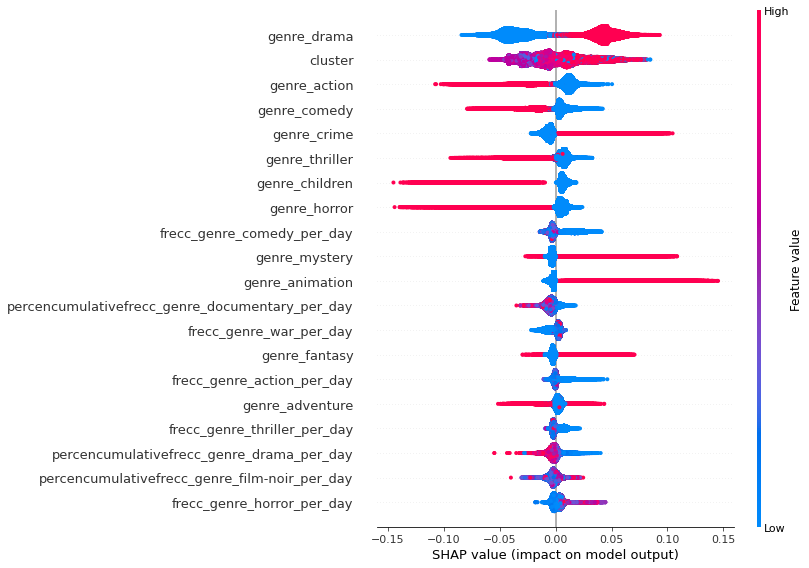

In [89]:
shap.summary_plot(shap_values,                   
                  features=X_test_p,
                  feature_names=X_test.columns)

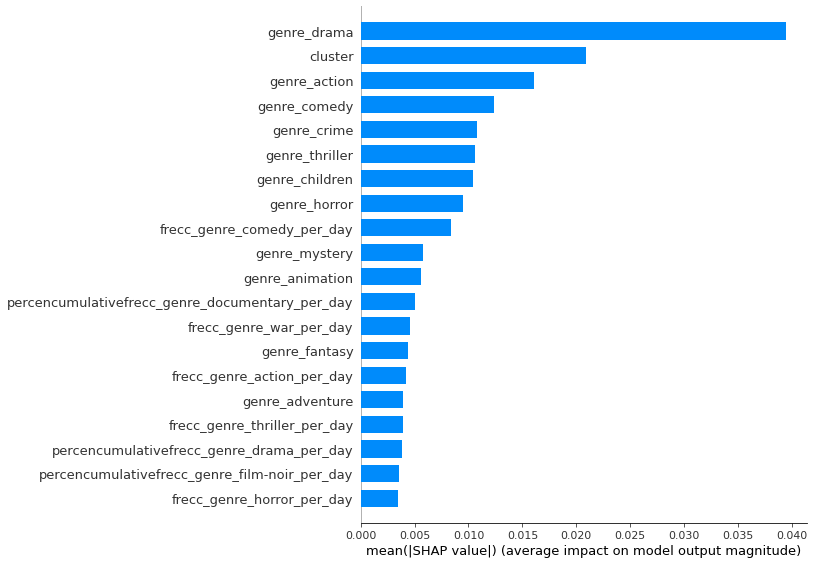

In [90]:
shap.summary_plot(shap_values,
                  features=X_test_p,
                  feature_names=X_test.columns,
                  plot_type="bar")

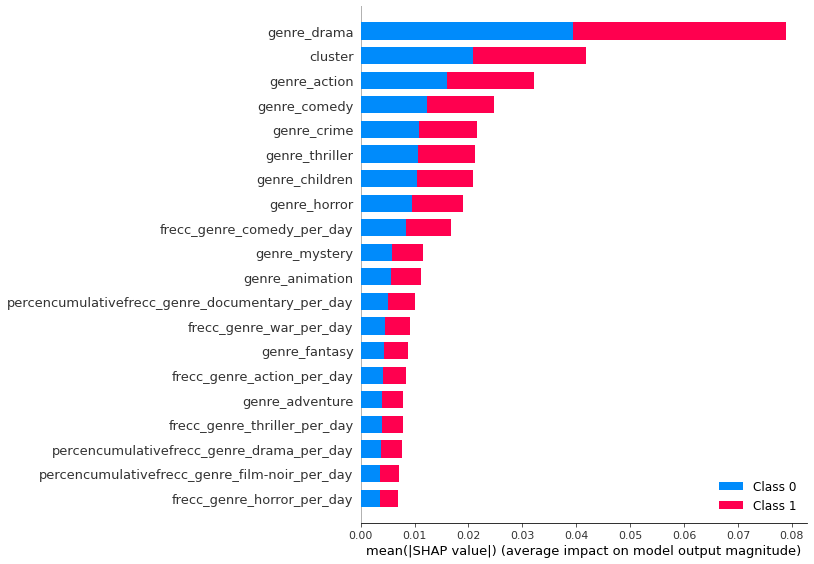

In [79]:
shap.summary_plot(shap_values,
                  features=X_test_p,
                  feature_names=X_test.columns)

In [ ]:
shap.dependence_plot('ExternalRiskEstimate',
                     shap_values,
                     X_test_pd,
                     interaction_index=None)

In [ ]:
shap.dependence_plot('ExternalRiskEstimate',
                     shap_values,
                     X_test_pd,
                     interaction_index='MSinceMostRecentInqexcl7days')

In [ ]:
shap_values

### Análisis de un valor individual

In [83]:
i=0

In [84]:
shap_values

[array([[ 0.00372247,  0.01230094, -0.        , ...,  0.0029377 ,
         -0.        , -0.0007471 ],
        [ 0.00544126,  0.00816706, -0.        , ...,  0.00203605,
         -0.        , -0.03725711],
        [-0.00316911,  0.01111666, -0.        , ...,  0.00286314,
         -0.        ,  0.00896366],
        ...,
        [-0.0007078 , -0.00189279, -0.        , ...,  0.00184869,
         -0.        ,  0.02126658],
        [-0.0034966 , -0.00059048, -0.        , ...,  0.00185581,
         -0.        , -0.06337406],
        [-0.00128094, -0.00031679, -0.        , ..., -0.02772077,
         -0.        , -0.01158652]]),
 array([[-0.00372247, -0.01230094,  0.        , ..., -0.0029377 ,
          0.        ,  0.0007471 ],
        [-0.00544126, -0.00816706,  0.        , ..., -0.00203605,
          0.        ,  0.03725711],
        [ 0.00316911, -0.01111666,  0.        , ..., -0.00286314,
          0.        , -0.00896366],
        ...,
        [ 0.0007078 ,  0.00189279,  0.        , ..., -

In [85]:
shap.plots._waterfall.waterfall_legacy(explainer.expected_value,
                                       shap_values[i],
                                       feature_names=X_test_pd.columns)

Exception: waterfall_plot requires a scalar expected_value of the model output as the first parameter, but you have passed an array as the first parameter! Try shap.waterfall_plot(explainer.expected_value[0], shap_values[0], X[0]) or for multi-output models try shap.waterfall_plot(explainer.expected_value[0], shap_values[0][0], X[0]).

In [ ]:
shap_values_pd_invidual = pd.DataFrame(shap_values_pd.iloc[i,0:20])
shap_values_pd_invidual.reset_index(inplace=True)
shap_values_pd_invidual.columns=['variables', 'values']
shap_values_pd_invidual['abs_values'] = abs(shap_values_pd_invidual['values'])
# shap_values_pd_invidual.rename(columns={f'{i}': 'values'}, inplace=True)
shap_values_pd_invidual.sort_values(by='abs_values', ascending=False, inplace=True)
shap_values_pd_invidual.reset_index(drop=True, inplace=True)
shap_values_pd_invidual

In [ ]:
shap.force_plot(explainer.expected_value,
                shap_values[i],
                X_test_p[i],
                feature_names=X_test_pd.columns)

In [ ]:
shap.force_plot(explainer.expected_value,
                shap_values[i],
                X_test_p[i],
                feature_names=X_test_pd.columns,
                link="logit")

In [ ]:

                               # F(x)-E(x) = suma de todos los shape values
0.177-explainer.expected_value # Contribución total

In [ ]:
i=2957

In [ ]:
shap_proba.loc[i, :]

In [ ]:
expected_value = explainer.expected_value
print("The expected value is ", expected_value)
# shap_values = explainer.shap_values(X_test_pd)[i]
shap.decision_plot(expected_value,
                   shap_values[i],
                   X_test_pd)

In [ ]:
shap_proba[shap_proba[1]>0.5].sort_values(1)